<a href="https://colab.research.google.com/github/Darpana-iitgn/ml_assignment_4/blob/main/task1_part2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#VGG 3 Augmented

In [ ]:
vgg3_aug = define_model()

In [ ]:
total_params = sum(p.numel() for p in vgg3_aug.parameters())
total_params

11169218

In [ ]:
if DEVICE == 'cuda':
  vgg3_aug.to('cuda')

In [ ]:
class_to_idx = aug_dataloaders['train'].dataset.dataset.class_to_idx
idx_to_class = {idx: cls for cls, idx in class_to_idx.items()}


In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(vgg3_aug.parameters())
n_epochs = 10

train_losses = []
val_losses = []
train_accuracy = []
valid_accuracy = []
training_time = []

writer1 = SummaryWriter(f'runs/vgg3_aug/')
step = 0
overall_start_time = time()
for epoch in range(n_epochs):
    train_loss = 0.0
    val_loss = 0.0
    train_acc = 0
    valid_acc = 0

    # Train the model
    vgg3_aug.train()
    start_time = time()
    for data, target in aug_dataloaders['train']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        optimizer.zero_grad()
        output = vgg3_aug(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        train_acc += acc.item() * data.size(0)

        writer1.add_scalar('Trainig Loss/ Iteration', loss, global_step = step)
        writer1.add_scalar('Training Accuracy / Iteration', acc, global_step = step)
        step += 1

    train_time = time() - start_time
    print(f'Training time in {epoch+1} is {train_time}\n')

    # Evaluate the model
    vgg3_aug.eval()
    for data, target in aug_dataloaders['val']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        output = vgg3_aug(data)
        loss = criterion(output, target)
        val_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        valid_acc += acc.item() * data.size(0)



    train_loss = train_loss/len(aug_dataloaders['train'].sampler)
    val_loss = val_loss/len(aug_dataloaders['val'].sampler)
    train_acc = train_acc / len(aug_dataloaders['train'].sampler)
    valid_acc = valid_acc / len(aug_dataloaders['val'].sampler)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracy.append(train_acc)
    valid_accuracy.append(valid_acc)
    training_time.append(train_time)

    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch+1,
        train_loss,
        val_loss
        ))


overall_train_time = time() - overall_start_time
print(f'Overall time taken for {epoch} including training and validation {overall_train_time}')

Training time in 1 is 9.594741344451904

Epoch: 1 	Training Loss: 2.426721 	Validation Loss: 0.497644
Training time in 2 is 9.042404890060425

Epoch: 2 	Training Loss: 0.652273 	Validation Loss: 0.668579
Training time in 3 is 7.815078258514404

Epoch: 3 	Training Loss: 0.610539 	Validation Loss: 0.597482
Training time in 4 is 9.457219123840332

Epoch: 4 	Training Loss: 0.512628 	Validation Loss: 1.187350
Training time in 5 is 8.627028942108154

Epoch: 5 	Training Loss: 0.482691 	Validation Loss: 1.412995
Training time in 6 is 8.758161306381226

Epoch: 6 	Training Loss: 0.403302 	Validation Loss: 0.772354
Training time in 7 is 9.497465133666992

Epoch: 7 	Training Loss: 0.366179 	Validation Loss: 0.659350
Training time in 8 is 8.770801782608032

Epoch: 8 	Training Loss: 0.302593 	Validation Loss: 1.062800
Training time in 9 is 10.879727125167847

Epoch: 9 	Training Loss: 0.263004 	Validation Loss: 0.694579
Training time in 10 is 9.224122762680054

Epoch: 10 	Training Loss: 0.233158 	Val

In [ ]:
vgg3_aug_acc_loss_time = pd.DataFrame([], columns = ['TrainingLoss', 'ValidationLoss', 'TrainingTime', 'TrainingAccuracy','ValidAccuracy', 'TestAccuracy', 'TotalParameters'  ])
vgg3_aug_acc_loss_time = pd.DataFrame({'TrainingLoss' : train_losses,
                              'ValidationLoss' : val_losses,
                              'TrainingTime' : training_time,
                              'TrainingAccuracy' : train_accuracy,
                              'ValidAccuracy' : valid_accuracy,
                              'TotalParameters': total_params
                              })
vgg3_aug_acc_loss_time

,TrainingLoss,ValidationLoss,TrainingTime,TrainingAccuracy,ValidAccuracy,TotalParameters
0,2.426721,0.497644,9.594741,0.600000,1.00,11169218
1,0.652273,0.668579,9.042405,0.600000,0.55,11169218
2,0.610539,0.597482,7.815078,0.692857,0.70,11169218
3,0.512628,1.187350,9.457219,0.757143,0.15,11169218
4,0.482691,1.412995,8.627029,0.742857,0.10,11169218
5,0.403302,0.772354,8.758161,0.835714,0.50,11169218
6,0.366179,0.659350,9.497465,0.800000,0.70,11169218
7,0.302593,1.062800,8.770802,0.885714,0.40,11169218
8,0.263004,0.694579,10.879727,0.900000,0.65,11169218
9,0.233158,1.012787,9.224123,0.914286,0.45,11169218


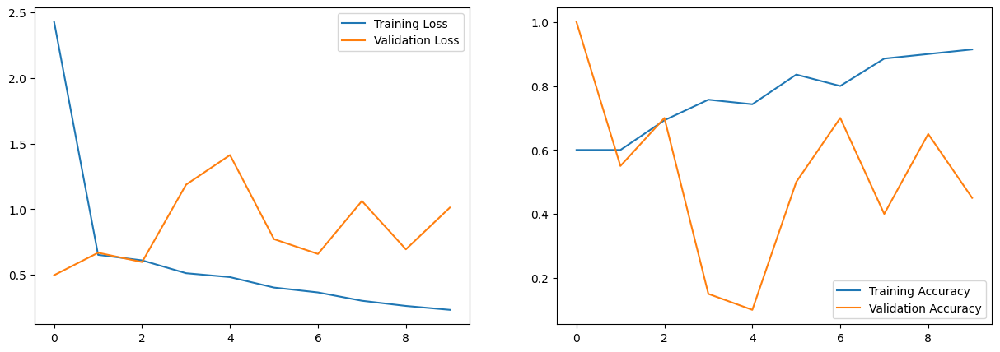

In [ ]:
fig , ax =plt.subplots(nrows=1,ncols =2, figsize = (15,5))
ax[0].plot( range(10), vgg3_aug_acc_loss_time['TrainingLoss'], label= 'Training Loss')
ax[0].plot( range(10), vgg3_aug_acc_loss_time['ValidationLoss'], label= 'Validation Loss')
ax[1].plot( range(10), vgg3_aug_acc_loss_time['TrainingAccuracy'], label= 'Training Accuracy')
ax[1].plot( range(10), vgg3_aug_acc_loss_time['ValidAccuracy'], label= 'Validation Accuracy')
ax[0].legend()
ax[1].legend()

In [ ]:
test_acc = 0
step = 0

test_images = []
test_labels = []
predictions = []

for input, target in aug_dataloaders['test']:
    if DEVICE == 'cuda':
        input, target = input.cuda(), target.cuda()

    output = vgg3_aug(input)
    pred = torch.argmax(input=output, dim=1)

    correct_labels = pred.eq(target.data.view_as(pred))
    acc = torch.mean(correct_labels.type(torch.FloatTensor))
    test_acc += acc.item() * input.size(0)

    test_images.append(input.cpu())
    test_labels.append(target.cpu())
    predictions.append(pred.cpu())

    img = input[0].cpu().squeeze().permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)

    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.set_title(f'Predicted: {idx_to_class[pred[0].item()]}')
    ax.set_axis_off()

    writer1.add_scalar('Testing Accuracy / Iteration', acc, global_step=step)
    writer1.add_figure('Test images & Label', fig, global_step=step)

    step += 1

test_acc = test_acc / len(aug_dataloaders['test'].sampler)
vgg3_aug_acc_loss_time['TestAccuracy'] = np.repeat(test_acc, len(vgg3_aug_acc_loss_time))

print(f'Testing accuracy is {test_acc}')

test_images = torch.cat(test_images, dim=0)
test_labels = torch.cat(test_labels, dim=0)
predictions = torch.cat(predictions, dim=0)

fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(12, 12))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < test_images.size(0):
        img = test_images[i].squeeze().permute(1, 2, 0).numpy()
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {idx_to_class[predictions[i].item()]}', fontsize=10)
        ax.set_axis_off()

plt.tight_layout()
writer1.add_figure('All Test Images & Predictions', fig)
plt.show()

Testing accuracy is 0.875


In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir runs/vgg3_aug

<IPython.core.display.Javascript object>

# VGG 16 (Fully connected layer)

In [ ]:
vgg16 = models.vgg16(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:07<00:00, 70.6MB/s]


In [ ]:
vgg16.classifier[6] = nn.Linear(vgg16.classifier[6].in_features, 2)
for params in vgg16.parameters():
  params.requires_grad = False

for params in vgg16.classifier.parameters():
  params.requires_grad = True

In [ ]:
if DEVICE == 'cuda':
  vgg16.to('cuda')

In [ ]:
summary(vgg16, input_size = (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
            Conv2d-3         [-1, 64, 224, 224]          36,928
              ReLU-4         [-1, 64, 224, 224]               0
         MaxPool2d-5         [-1, 64, 112, 112]               0
            Conv2d-6        [-1, 128, 112, 112]          73,856
              ReLU-7        [-1, 128, 112, 112]               0
            Conv2d-8        [-1, 128, 112, 112]         147,584
              ReLU-9        [-1, 128, 112, 112]               0
        MaxPool2d-10          [-1, 128, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]         295,168
             ReLU-12          [-1, 256, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]         590,080
             ReLU-14          [-1, 256,

In [ ]:
vgg16.class_to_idx =  images['train'].class_to_idx
vgg16.idx_to_class = {
    idx: class_
    for class_, idx in vgg16.class_to_idx.items()
}

list(vgg16.idx_to_class.items())[:10]

[(0, 'ants'), (1, 'dogs')]

In [ ]:
total_params = sum(p.numel() for p in vgg16.parameters())
total_params

134268738

In [ ]:
total_parameters = sum(params.numel() for params in vgg16.parameters())
print(f'Total Parameters {total_parameters}')

trainable_parameters = sum(params.numel() for params in vgg16.parameters() if params.requires_grad)
print(f'Trainable Parameters {trainable_parameters}')

Total Parameters 134268738
Trainable Parameters 119554050


In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(vgg16.parameters())
n_epochs = 10

train_losses = []
val_losses = []
train_accuracy = []
valid_accuracy = []
training_time = []

writer = SummaryWriter(f'runs/vgg16/')
step = 0
overall_start_time = time()
for epoch in range(n_epochs):
    train_loss = 0.0
    val_loss = 0.0
    train_acc = 0
    valid_acc = 0

    # Train the model
    vgg16.train()
    start_time = time()
    for data, target in dataloaders['train']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        optimizer.zero_grad()
        output = vgg16(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        train_acc += acc.item() * data.size(0)

        writer.add_scalar('Trainig Loss/ Iteration', loss, global_step = step)
        writer.add_scalar('Training Accuracy / Iteration', acc, global_step = step)

        step += 1

    train_time = time() - start_time
    print(f'Training time in {epoch+1} is {train_time}\n')

    # Evaluate the model
    vgg16.eval()
    for data, target in dataloaders['val']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        output = vgg16(data)
        loss = criterion(output, target)
        val_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        valid_acc += acc.item() * data.size(0)



    # Calculate average losses
    train_loss = train_loss/len(dataloaders['train'].sampler)
    val_loss = val_loss/len(dataloaders['val'].sampler)
    train_acc = train_acc / len(dataloaders['train'].sampler)
    valid_acc = valid_acc / len(dataloaders['val'].sampler)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracy.append(train_acc)
    valid_accuracy.append(valid_acc)
    training_time.append(train_time)

    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch+1,
        train_loss,
        val_loss
        ))


overall_train_time = time() - overall_start_time
print(f'Overall time taken for {epoch} including training and validation {overall_train_time}')

Training time in 1 is 9.925251007080078

Epoch: 1 	Training Loss: 0.118527 	Validation Loss: 0.000000
Training time in 2 is 9.311867237091064

Epoch: 2 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 3 is 8.31879711151123

Epoch: 3 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 4 is 9.812844276428223

Epoch: 4 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 5 is 8.98769211769104

Epoch: 5 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 6 is 8.709390640258789

Epoch: 6 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 7 is 9.721763610839844

Epoch: 7 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 8 is 8.763848066329956

Epoch: 8 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 9 is 9.013748407363892

Epoch: 9 	Training Loss: 0.000000 	Validation Loss: 0.000000
Training time in 10 is 9.785085916519165

Epoch: 10 	Training Loss: 0.000000 	Valida

In [ ]:
vgg16_acc_loss_time = pd.DataFrame([], columns = ['TrainingLoss','ValidationLoss', 'TrainingTime', 'TrainingAccuracy','ValidAccuracy', 'TestAccuracy','TotalParameters'  ])
vgg16_acc_loss_time = pd.DataFrame({'TrainingLoss' : train_losses,
                              'ValidationLoss' : val_losses,
                              'TrainingTime' : training_time,
                              'TrainingAccuracy' : train_accuracy,
                              'ValidAccuracy' : valid_accuracy,
                                    'TotalParameters': total_params
                              })
vgg16_acc_loss_time

,TrainingLoss,ValidationLoss,TrainingTime,TrainingAccuracy,ValidAccuracy,TotalParameters
0,0.118527,0.0,9.925251,0.95,1.0,134268738
1,0.000000,0.0,9.311867,1.00,1.0,134268738
2,0.000000,0.0,8.318797,1.00,1.0,134268738
3,0.000000,0.0,9.812844,1.00,1.0,134268738
4,0.000000,0.0,8.987692,1.00,1.0,134268738
5,0.000000,0.0,8.709391,1.00,1.0,134268738
6,0.000000,0.0,9.721764,1.00,1.0,134268738
7,0.000000,0.0,8.763848,1.00,1.0,134268738
8,0.000000,0.0,9.013748,1.00,1.0,134268738
9,0.000000,0.0,9.785086,1.00,1.0,134268738


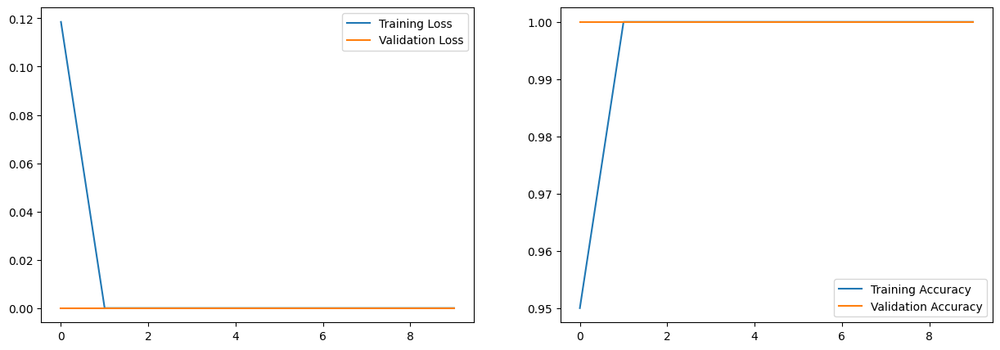

In [ ]:
fig , ax =plt.subplots(nrows=1,ncols =2, figsize = (15,5))
ax[0].plot( range(10), vgg16_acc_loss_time['TrainingLoss'], label= 'Training Loss')
ax[0].plot( range(10), vgg16_acc_loss_time['ValidationLoss'], label= 'Validation Loss')
ax[1].plot( range(10), vgg16_acc_loss_time['TrainingAccuracy'], label= 'Training Accuracy')
ax[1].plot( range(10), vgg16_acc_loss_time['ValidAccuracy'], label= 'Validation Accuracy')
ax[0].legend()
ax[1].legend()

In [ ]:
test_acc = 0
step = 0

test_images = []
test_labels = []
predictions = []

for input, target in dataloaders['test']:
    if DEVICE == 'cuda':
        input, target = input.cuda(), target.cuda()

    output = vgg16(input)
    pred = torch.argmax(input=output, dim=1)

    correct_labels = pred.eq(target.data.view_as(pred))
    acc = torch.mean(correct_labels.type(torch.FloatTensor))
    test_acc += acc.item() * input.size(0)

    test_images.append(input.cpu())
    test_labels.append(target.cpu())
    predictions.append(pred.cpu())

    img = input[0].cpu().squeeze().permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)

    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.set_title(f'Predicted: {vgg16.idx_to_class[pred[0].item()]}')
    ax.set_axis_off()

    writer.add_scalar('Testing Accuracy / Iteration', acc, global_step=step)
    writer.add_figure('Test images & Label', fig, global_step=step)

    step += 1

test_acc = test_acc / len(dataloaders['test'].sampler)
vgg16_acc_loss_time['TestAccuracy'] = np.repeat(test_acc, len(vgg16_acc_loss_time))

print(f'Testing accuracy is {test_acc}')

test_images = torch.cat(test_images, dim=0)
test_labels = torch.cat(test_labels, dim=0)
predictions = torch.cat(predictions, dim=0)

fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(12, 12))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < test_images.size(0):
        img = test_images[i].squeeze().permute(1, 2, 0).numpy()
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {vgg16.idx_to_class[predictions[i].item()]}', fontsize=10)
        ax.set_axis_off()

plt.tight_layout()
writer.add_figure('All Test Images & Predictions', fig)
plt.show()

Testing accuracy is 1.0


In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir runs/vgg16

<IPython.core.display.Javascript object>

# VGG16 (Fine Tuning)

In [ ]:
vgg16_ft = models.vgg16(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
vgg16_ft.classifier[6] = nn.Linear(vgg16_ft.classifier[6].in_features, 2)


In [ ]:
if DEVICE == 'cuda':
  vgg16_ft.to('cuda')

In [ ]:
vgg16_ft.class_to_idx =  images['train'].class_to_idx
vgg16_ft.idx_to_class = {
    idx: class_
    for class_, idx in vgg16_ft.class_to_idx.items()
}

list(vgg16_ft.idx_to_class.items())[:10]

[(0, 'ants'), (1, 'dogs')]

In [ ]:
summary(vgg16_ft, input_size = (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
            Conv2d-3         [-1, 64, 224, 224]          36,928
              ReLU-4         [-1, 64, 224, 224]               0
         MaxPool2d-5         [-1, 64, 112, 112]               0
            Conv2d-6        [-1, 128, 112, 112]          73,856
              ReLU-7        [-1, 128, 112, 112]               0
            Conv2d-8        [-1, 128, 112, 112]         147,584
              ReLU-9        [-1, 128, 112, 112]               0
        MaxPool2d-10          [-1, 128, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]         295,168
             ReLU-12          [-1, 256, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]         590,080
             ReLU-14          [-1, 256,

In [ ]:
total_params = sum(p.numel() for p in vgg16_ft.parameters())
total_params

134268738

In [ ]:
total_parameters = sum(params.numel() for params in vgg16_ft.parameters())
print(f'Total Parameters {total_parameters}')

trainable_parameters = sum(params.numel() for params in vgg16_ft.parameters() if params.requires_grad)
print(f'Trainable Parameters {trainable_parameters}')

Total Parameters 134268738
Trainable Parameters 134268738


In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(vgg16_ft.parameters())
n_epochs = 10

train_losses = []
val_losses = []
train_accuracy = []
valid_accuracy = []
training_time = []

writer = SummaryWriter(f'runs/vgg16_ft/')
step = 0
overall_start_time = time()
for epoch in range(n_epochs):
    train_loss = 0.0
    val_loss = 0.0
    train_acc = 0
    valid_acc = 0

    # Train the model
    vgg16_ft.train()
    start_time = time()
    for data, target in dataloaders['train']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        optimizer.zero_grad()
        output = vgg16_ft(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        train_acc += acc.item() * data.size(0)

        writer.add_scalar('Trainig Loss/ Iteration', loss, global_step = step)
        writer.add_scalar('Training Accuracy / Iteration', acc, global_step = step)

        step += 1

    train_time = time() - start_time
    print(f'Training time in {epoch+1} is {train_time}\n')

    # Evaluate the model
    vgg16_ft.eval()
    for data, target in dataloaders['val']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        output = vgg16_ft(data)
        loss = criterion(output, target)
        val_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        valid_acc += acc.item() * data.size(0)



    # Calculate average losses
    train_loss = train_loss/len(dataloaders['train'].sampler)
    val_loss = val_loss/len(dataloaders['val'].sampler)
    train_acc = train_acc / len(dataloaders['train'].sampler)
    valid_acc = valid_acc / len(dataloaders['val'].sampler)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracy.append(train_acc)
    valid_accuracy.append(valid_acc)
    training_time.append(train_time)

    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch+1,
        train_loss,
        val_loss
        ))


overall_train_time = time() - overall_start_time
print(f'Overall time taken for {epoch} including training and validation {overall_train_time}')

Training time in 1 is 22.681403160095215

Epoch: 1 	Training Loss: 3.611618 	Validation Loss: 0.438130
Training time in 2 is 21.41207003593445

Epoch: 2 	Training Loss: 0.678074 	Validation Loss: 1.523811
Training time in 3 is 11.776687145233154

Epoch: 3 	Training Loss: 0.793995 	Validation Loss: 1.201091
Training time in 4 is 11.435560703277588

Epoch: 4 	Training Loss: 0.746119 	Validation Loss: 1.649649
Training time in 5 is 11.15595293045044

Epoch: 5 	Training Loss: 0.630523 	Validation Loss: 0.200246
Training time in 6 is 10.30342149734497

Epoch: 6 	Training Loss: 0.566844 	Validation Loss: 0.404112
Training time in 7 is 10.323180913925171

Epoch: 7 	Training Loss: 0.561365 	Validation Loss: 0.354835
Training time in 8 is 11.242634534835815

Epoch: 8 	Training Loss: 0.743805 	Validation Loss: 0.490559
Training time in 9 is 11.45433497428894

Epoch: 9 	Training Loss: 0.705231 	Validation Loss: 0.873361
Training time in 10 is 10.003639698028564

Epoch: 10 	Training Loss: 0.673153

In [ ]:
vgg16_ft_acc_loss_time = pd.DataFrame([], columns = ['TrainingLoss','ValidationLoss', 'TrainingTime', 'TrainingAccuracy','ValidAccuracy', 'TestAccuracy','TotalParameters'  ])
vgg16_ft_acc_loss_time = pd.DataFrame({'TrainingLoss' : train_losses,
                              'ValidationLoss' : val_losses,
                              'TrainingTime' : training_time,
                              'TrainingAccuracy' : train_accuracy,
                              'ValidAccuracy' : valid_accuracy,
                                       'TotalParameters': total_params
                              })
vgg16_ft_acc_loss_time

,TrainingLoss,ValidationLoss,TrainingTime,TrainingAccuracy,ValidAccuracy,TotalParameters
0,3.611618,0.438130,22.681403,0.557143,1.00,134268738
1,0.678074,1.523811,21.412070,0.578571,0.00,134268738
2,0.793995,1.201091,11.776687,0.500000,0.05,134268738
3,0.746119,1.649649,11.435561,0.592857,0.15,134268738
4,0.630523,0.200246,11.155953,0.657143,1.00,134268738
5,0.566844,0.404112,10.303421,0.742857,0.85,134268738
6,0.561365,0.354835,10.323181,0.721429,0.85,134268738
7,0.743805,0.490559,11.242635,0.671429,1.00,134268738
8,0.705231,0.873361,11.454335,0.514286,0.00,134268738
9,0.673153,0.758506,10.003640,0.557143,0.00,134268738


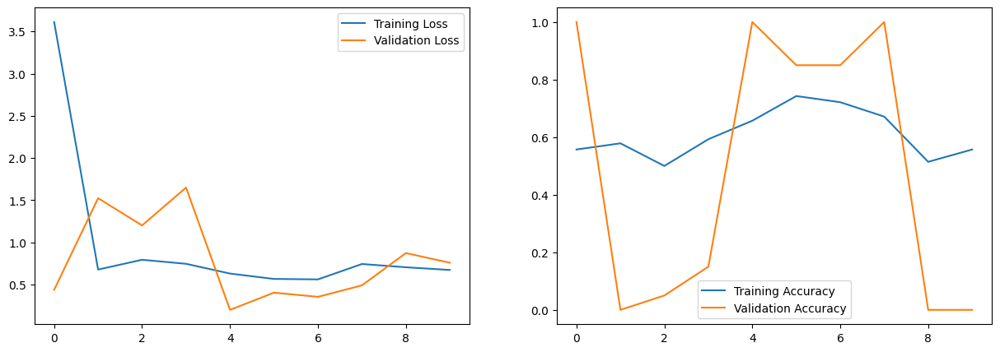

In [ ]:
fig , ax =plt.subplots(nrows=1,ncols =2, figsize = (15,5))
ax[0].plot( range(10), vgg16_ft_acc_loss_time['TrainingLoss'], label= 'Training Loss')
ax[0].plot( range(10), vgg16_ft_acc_loss_time['ValidationLoss'], label= 'Validation Loss')
ax[1].plot( range(10), vgg16_ft_acc_loss_time['TrainingAccuracy'], label= 'Training Accuracy')
ax[1].plot( range(10), vgg16_ft_acc_loss_time['ValidAccuracy'], label= 'Validation Accuracy')
ax[0].legend()
ax[1].legend()

In [ ]:
test_acc = 0
step = 0

test_images = []
test_labels = []
predictions = []

for input, target in dataloaders['test']:
    if DEVICE == 'cuda':
        input, target = input.cuda(), target.cuda()

    output = vgg16_ft(input)
    pred = torch.argmax(input=output, dim=1)

    correct_labels = pred.eq(target.data.view_as(pred))
    acc = torch.mean(correct_labels.type(torch.FloatTensor))
    test_acc += acc.item() * input.size(0)

    test_images.append(input.cpu())
    test_labels.append(target.cpu())
    predictions.append(pred.cpu())

    img = input[0].cpu().squeeze().permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)

    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.set_title(f'Predicted: {vgg3.idx_to_class[pred[0].item()]}')
    ax.set_axis_off()

    writer.add_scalar('Testing Accuracy / Iteration', acc, global_step=step)
    writer.add_figure('Test images & Label', fig, global_step=step)

    step += 1

test_acc = test_acc / len(dataloaders['test'].sampler)
vgg16_ft_acc_loss_time['TestAccuracy'] = np.repeat(test_acc, len(vgg16_ft_acc_loss_time))

print(f'Testing accuracy is {test_acc}')

test_images = torch.cat(test_images, dim=0)
test_labels = torch.cat(test_labels, dim=0)
predictions = torch.cat(predictions, dim=0)

fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(12, 12))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < test_images.size(0):
        img = test_images[i].squeeze().permute(1, 2, 0).numpy()
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {vgg16_ft.idx_to_class[predictions[i].item()]}', fontsize=10)
        ax.set_axis_off()

plt.tight_layout()
writer.add_figure('All Test Images & Predictions', fig)
plt.show()

Testing accuracy is 0.475


In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir runs/vgg16_ft

<IPython.core.display.Javascript object>

# Training MLP

In [ ]:
MLP = nn.Sequential(
    nn.Linear(150528, 900),
    nn.ReLU(),
    nn.Linear(900, 512),
    nn.ReLU(),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Linear(256,128),
    nn.ReLU(),
    nn.Linear(128,2)
)
if DEVICE == 'cuda':
  MLP.to('cuda')

In [ ]:
MLP.class_to_idx =  images['train'].class_to_idx
MLP.idx_to_class = {
    idx: class_
    for class_, idx in images['train'].class_to_idx.items()
}

list(MLP.idx_to_class.items())[:10]

[(0, 'ants'), (1, 'dogs')]

In [ ]:
summary(MLP, input_size = (150528,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                  [-1, 900]     135,476,100
              ReLU-2                  [-1, 900]               0
            Linear-3                  [-1, 512]         461,312
              ReLU-4                  [-1, 512]               0
            Linear-5                  [-1, 256]         131,328
              ReLU-6                  [-1, 256]               0
            Linear-7                  [-1, 128]          32,896
              ReLU-8                  [-1, 128]               0
            Linear-9                    [-1, 2]             258
Total params: 136,101,894
Trainable params: 136,101,894
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.57
Forward/backward pass size (MB): 0.03
Params size (MB): 519.19
Estimated Total Size (MB): 519.79
-------------------------------

In [ ]:
total_params = sum(p.numel() for p in MLP.parameters())
total_params

136101894

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(MLP.parameters())
n_epochs = 10

train_losses = []
val_losses = []
train_accuracy = []
valid_accuracy = []
training_time = []

writer = SummaryWriter(f'runs/MLP/')
step = 0
overall_start_time = time()
for epoch in range(n_epochs):
    train_loss = 0.0
    val_loss = 0.0
    train_acc = 0
    valid_acc = 0

    # Train the model
    MLP.train()
    start_time = time()
    for data, target in dataloaders['train']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
        optimizer.zero_grad()
        output = MLP(data.view(data.size(0), -1))
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        train_acc += acc.item() * data.size(0)

        writer.add_scalar('Trainig Loss/ Iteration', loss, global_step = step)
        writer.add_scalar('Training Accuracy / Iteration', acc, global_step = step)

        step += 1

    train_time = time() - start_time
    print(f'Training time in {epoch+1} is {train_time}\n')

    # Evaluate the model
    MLP.eval()
    for data, target in dataloaders['val']:
        if DEVICE == 'cuda':
          data, target = data.cuda(), target.cuda()
          output = MLP(data.view(data.size(0), -1))
        loss = criterion(output, target)
        val_loss += loss.item()*data.size(0)

        pred = torch.argmax(input = output, dim = 1)
        correct_labels = pred.eq(target.data.view_as(pred))
        acc = torch.mean(correct_labels.type(torch.FloatTensor))
        valid_acc += acc.item() * data.size(0)



    # Calculate average losses
    train_loss = train_loss/len(dataloaders['train'].sampler)
    val_loss = val_loss/len(dataloaders['val'].sampler)
    train_acc = train_acc / len(dataloaders['train'].sampler)
    valid_acc = valid_acc / len(dataloaders['val'].sampler)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracy.append(train_acc)
    valid_accuracy.append(valid_acc)
    training_time.append(train_time)

    # Print training/validation statistics
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch+1,
        train_loss,
        val_loss
        ))


overall_train_time = time() - overall_start_time
print(f'Overall time taken for {epoch} including training and validation {overall_train_time}')

Training time in 1 is 10.057003498077393

Epoch: 1 	Training Loss: 3.331996 	Validation Loss: 0.352506
Training time in 2 is 7.477569818496704

Epoch: 2 	Training Loss: 1.173846 	Validation Loss: 0.925540
Training time in 3 is 9.333528518676758

Epoch: 3 	Training Loss: 0.979502 	Validation Loss: 3.514634
Training time in 4 is 7.46643328666687

Epoch: 4 	Training Loss: 0.408282 	Validation Loss: 2.963339
Training time in 5 is 9.075960874557495

Epoch: 5 	Training Loss: 0.172898 	Validation Loss: 4.192440
Training time in 6 is 7.989628076553345

Epoch: 6 	Training Loss: 0.071565 	Validation Loss: 2.881589
Training time in 7 is 8.422188758850098

Epoch: 7 	Training Loss: 0.156660 	Validation Loss: 5.601532
Training time in 8 is 8.645586252212524

Epoch: 8 	Training Loss: 0.080247 	Validation Loss: 5.091118
Training time in 9 is 8.382052659988403

Epoch: 9 	Training Loss: 0.014830 	Validation Loss: 4.931360
Training time in 10 is 9.187229633331299

Epoch: 10 	Training Loss: 0.010226 	Vali

In [ ]:
mlp_acc_loss_time = pd.DataFrame([], columns = ['TrainingLoss','ValidationLoss', 'TrainingTime', 'TrainingAccuracy','ValidAccuracy', 'TestAccuracy','TotalParameters'  ])
mlp_acc_loss_time = pd.DataFrame({'TrainingLoss' : train_losses,
                              'ValidationLoss' : val_losses,
                              'TrainingTime' : training_time,
                              'TrainingAccuracy' : train_accuracy,
                              'ValidAccuracy' : valid_accuracy,
                                  'TotalParameters':total_params
                              })
mlp_acc_loss_time

,TrainingLoss,ValidationLoss,TrainingTime,TrainingAccuracy,ValidAccuracy,TotalParameters
0,3.331996,0.352506,10.057003,0.578571,0.95,136101894
1,1.173846,0.925540,7.477570,0.764286,0.60,136101894
2,0.979502,3.514634,9.333529,0.785714,0.30,136101894
3,0.408282,2.963339,7.466433,0.857143,0.35,136101894
4,0.172898,4.192440,9.075961,0.942857,0.30,136101894
5,0.071565,2.881589,7.989628,0.985714,0.35,136101894
6,0.156660,5.601532,8.422189,0.964286,0.25,136101894
7,0.080247,5.091118,8.645586,0.985714,0.30,136101894
8,0.014830,4.931360,8.382053,0.985714,0.35,136101894
9,0.010226,10.126987,9.187230,1.000000,0.30,136101894


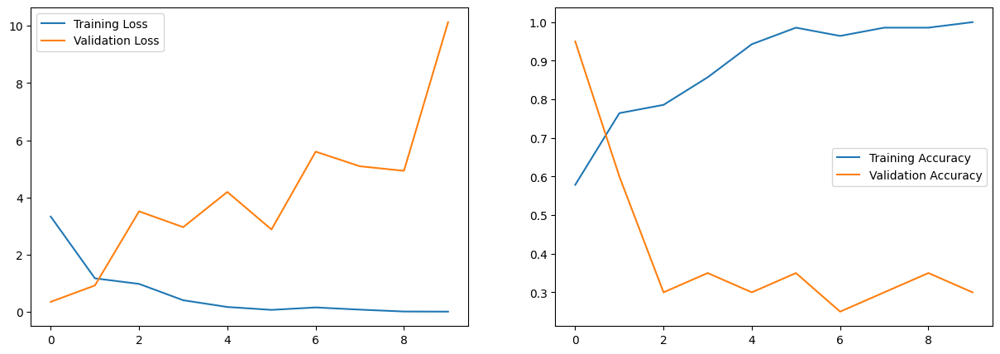

In [ ]:
fig , ax =plt.subplots(nrows=1,ncols =2, figsize = (15,5))
ax[0].plot( range(10), mlp_acc_loss_time['TrainingLoss'], label= 'Training Loss')
ax[0].plot( range(10), mlp_acc_loss_time['ValidationLoss'], label= 'Validation Loss')
ax[1].plot( range(10), mlp_acc_loss_time['TrainingAccuracy'], label= 'Training Accuracy')
ax[1].plot( range(10), mlp_acc_loss_time['ValidAccuracy'], label= 'Validation Accuracy')
ax[0].legend()
ax[1].legend()

In [ ]:
test_acc = 0
step = 0

test_images = []
test_labels = []
predictions = []

for input, target in dataloaders['test']:
    if DEVICE == 'cuda':
        input, target = input.cuda(), target.cuda()

    output = MLP(input.view(input.size(0), -1))
    pred = torch.argmax(input=output, dim=1)

    correct_labels = pred.eq(target.data.view_as(pred))
    acc = torch.mean(correct_labels.type(torch.FloatTensor))
    test_acc += acc.item() * input.size(0)

    test_images.append(input.cpu())
    test_labels.append(target.cpu())
    predictions.append(pred.cpu())

    img = input[0].cpu().squeeze().permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)

    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.set_title(f'Predicted: {vgg3.idx_to_class[pred[0].item()]}')
    ax.set_axis_off()

    writer.add_scalar('Testing Accuracy / Iteration', acc, global_step=step)
    writer.add_figure('Test images & Label', fig, global_step=step)

    step += 1

test_acc = test_acc / len(dataloaders['test'].sampler)
mlp_acc_loss_time['TestAccuracy'] = np.repeat(test_acc, len(mlp_acc_loss_time))

print(f'Testing accuracy is {test_acc}')

test_images = torch.cat(test_images, dim=0)
test_labels = torch.cat(test_labels, dim=0)
predictions = torch.cat(predictions, dim=0)

fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(12, 12))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < test_images.size(0):
        img = test_images[i].squeeze().permute(1, 2, 0).numpy()
        img = np.clip(img, 0, 1)
        ax.imshow(img)
        ax.set_title(f'Pred: {MLP.idx_to_class[predictions[i].item()]}', fontsize=10)
        ax.set_axis_off()

plt.tight_layout()
writer.add_figure('All Test Images & Predictions', fig)
plt.show()

Testing accuracy is 0.85


In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir runs/MLP

<IPython.core.display.Javascript object>

# Results

In [ ]:
combined_table = pd.concat([vgg1_acc_loss_time.mean(),vgg3_acc_loss_time.mean(), vgg3_aug_acc_loss_time.mean(),vgg16_acc_loss_time.mean(),vgg16_ft_acc_loss_time.mean(),mlp_acc_loss_time.mean()], axis = 1).T
combined_table.index = ['VGG1','VGG3','VGG3_augmentation','VGG16_FC','VGG16_entire','MLP']
combined_table

,TrainingLoss,ValidationLoss,TrainingTime,TrainingAccuracy,ValidAccuracy,TotalParameters,TestAccuracy
VGG1,3.800688,9.216494,7.758135,0.906429,0.635,50468098.0,0.925
VGG3,0.301374,1.591280,7.862081,0.870000,0.390,11169218.0,0.900
VGG3_augmentation,0.625309,0.856592,9.166675,0.772857,0.520,11169218.0,0.875
VGG16_FC,0.011853,0.000000,9.235029,0.995000,1.000,134268738.0,1.000
VGG16_entire,0.971073,0.789430,13.178889,0.609286,0.490,134268738.0,0.475
MLP,0.640005,4.058105,8.603718,0.885000,0.405,136101894.0,0.850


# Theory

- Are the results as expected? Why or why not?

VGG1, being the simplest, shows lower accuracy compared to other models, which have more layers and can capture more complex features from the images
VGG3 and VGG3_aug should perform slightly better than VGG1 due to the increased depth and the effect of data augmentation. Data augmentation (such as random rotations, flips, or color changes) usually improves the generalization of the model by preventing overfitting on the training data, which may explain better performance

VGG16: This model is typically stronger in performance because it has many more layers, allowing it to capture finer details in images, as it has more parameters and can capture complex features. When fine-tuning the entire VGG16 model, the entire model adapts to the specific task of distinguishing between dogs and ants. Fine-tuning allows the model to better adjust the convolutional layers for specific features in the new dataset.

MLP (Multilayer Perceptron): MLP models typically underperform on image data compared to CNN-based models like VGG. Since MLPs don’t have convolutional layers, they don't capture spatial hierarchies effectively, making them less suitable for tasks involving images. However, if trained properly, MLPs may still give reasonable performance on simpler datasets.

   

 - Does data augmentation help? Why or why not?

Data augmentation artificially increases the size and variability of the training dataset by applying random transformations (e.g., rotation, flipping, zoom, cropping). This helps the models generalize better, especially in tasks like distinguishing between dogs and ants, where visual differences might be subtle. For example, an ant on a leaf might look very similar to a dog in the background of an image. Augmentation makes sure the model doesn’t memorize specific features of the training set but learns generalizable patterns.
   

 - Does it matter how many epochs you fine-tune the model? Why or why not?

Yes, the number of epochs is critical in fine-tuning. Underfitting and overfitting: If you fine-tune for too few epochs, the model won’t have enough time to adjust its weights, especially the convolutional layers, to the new dataset (dogs vs ants). The model will perform poorly on the test set.

  

  - Are there any particular images that the model is confused about? Why or why not?
  
Intra-class variability: Both dogs and ants can appear in a variety of poses, colors, and sizes. The model could get confused if the dog or ant in the image has an unusual appearance. For instance, a fluffy white dog may resemble a large white ant in certain environments.

Inter-class similarity: Ants and dogs may share visual similarities, especially in terms of color patterns, textures, and object sizes. For example, ants may appear as small, textured, dark objects on a similarly colored background, which may resemble a dog’s fur in certain positions.

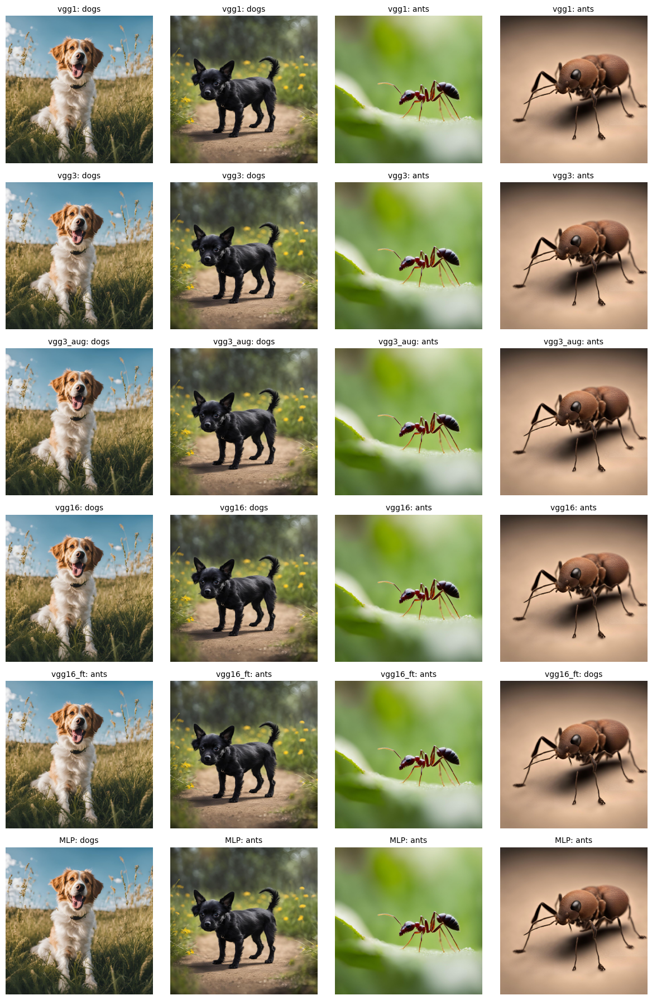

In [ ]:
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

image_paths = ['/content/drive/MyDrive/dog_easy.jpg', "/content/drive/MyDrive/dog_hard.jpg", "/content/drive/MyDrive/ants_easy.jpg", "/content/drive/MyDrive/ants_hard_better.jpg"]

images = [Image.open(image_path).convert('RGB') for image_path in image_paths]
inputs = torch.stack([transform(image) for image in images])  # Shape should be [4, 3, 224, 224]

if DEVICE == 'cuda':
    inputs = inputs.cuda()

models = {
    'vgg1': vgg1.eval(),
    'vgg3': vgg3.eval(),
    'vgg3_aug': vgg3_aug.eval(),
    'vgg16': vgg16.eval(),
    'vgg16_ft': vgg16_ft.eval(),
    'MLP': MLP.eval()
}

fig, axes = plt.subplots(6, 4, figsize=(12, 18))  # 6 rows (one for each model), 4 columns (one for each image)

for model_idx, (model_name, model) in enumerate(models.items()):
    if model_name == 'MLP':
        inputs_flattened = inputs.view(inputs.size(0), -1)
        outputs = model(inputs_flattened)
    else:
        outputs = model(inputs)

    predictions = torch.argmax(outputs, dim=1)

    for i, ax in enumerate(axes[model_idx]):
        img = images[i]
        ax.imshow(img)
        ax.set_title(f'{model_name}: {idx_to_class[predictions[i].item()]}', fontsize=10)
        ax.set_axis_off()

plt.tight_layout()
plt.show()
